In [47]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib
from IPython.display import HTML
from filters import kalman_filter, particle_filter, particle_filter_runs
from plotting_tools import box_plot_particles, plot_particle_loglog, plot_particle_convergence

State space model:
$$x_{t}=A\cdot x_{t-1}+w_{t}$$
where $w\sim  \mathcal{N}(0,Q)$. $A$ is the state transition matrix, $Q$ is the noise covariance.

Observation model:
$$y_{t}=C\cdot x_{t}+v_{t}$$
where $v_{t}\sim\mathcal{N}(0,R)$. $C$ is the observation matrix, $R$ is the noise covariance.

In [11]:
T = 100
A = np.array([[0.8, 0.4], [0.2, 0.6]])  # State transition matrix
Q = np.array([[0.1, 0.01], [0.01, 0.9]])  # Process noise covariance
C = np.array([[1.0, 0.0], [0.0, 1.0]])  # Observation matrix
R = np.array([[0.02, 0.001], [0.001, 0.02]])  # Observation noise covariance
mu_0 = np.array([0.0, 0.0])  # Mean of the initial state
Sigma_0 = np.array([[1.0, 0.0], [0.0, 1.0]])  # Covariance of the initial state

x = np.zeros((T, 2))
y = np.zeros((T, 2))

Initial state $$x_0\sim\mathcal{N}(\mu_{0}, \Sigma_{0})$$

In [22]:
np.random.seed(69)
x[0] = np.random.multivariate_normal(mu_0, Sigma_0)
for t in range(1, T):
    x[t] = A @ x[t - 1] + np.random.multivariate_normal(np.zeros(2), Q)

for t in range(T):
    y[t] = C @ x[t] + np.random.multivariate_normal(np.zeros(2), R)

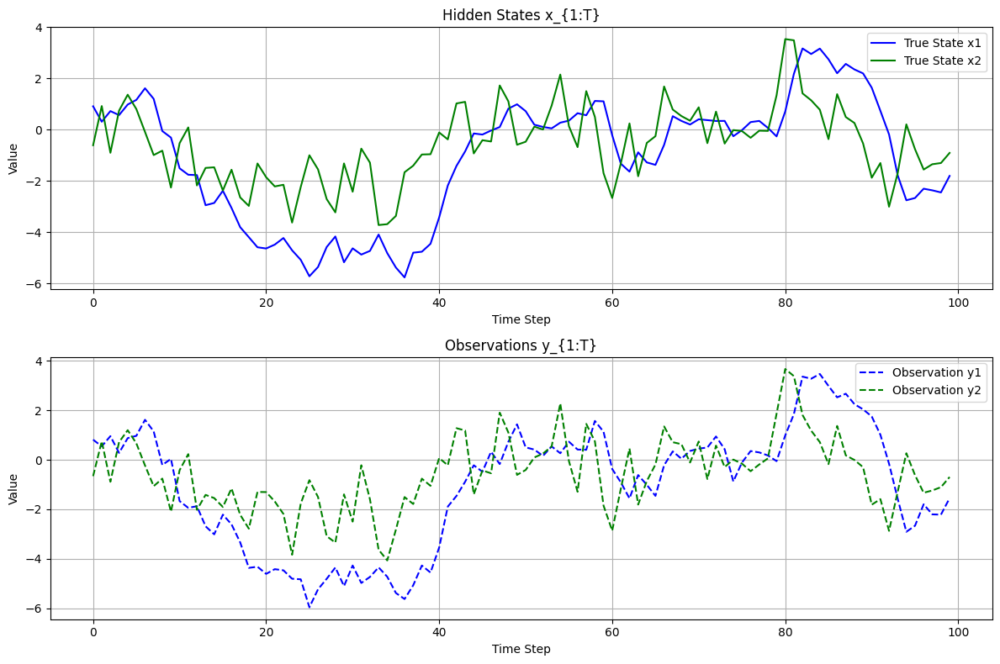

In [9]:
# Plot simulated data
plt.figure(figsize=(12, 8))

# Plot hidden states
plt.subplot(2, 1, 1)
plt.plot(range(T), x[:, 0], label="True State x1", color="blue")
plt.plot(range(T), x[:, 1], label="True State x2", color="green")
plt.title("Hidden States x_{1:T}")
plt.xlabel("Time Step")
plt.ylabel("Value")
plt.legend()
plt.grid()

# Plot observations
plt.subplot(2, 1, 2)
plt.plot(range(T), y[:, 0], label="Observation y1", color="blue", linestyle="--")
plt.plot(range(T), y[:, 1], label="Observation y2", color="green", linestyle="--")
plt.title("Observations y_{1:T}")
plt.xlabel("Time Step")
plt.ylabel("Value")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

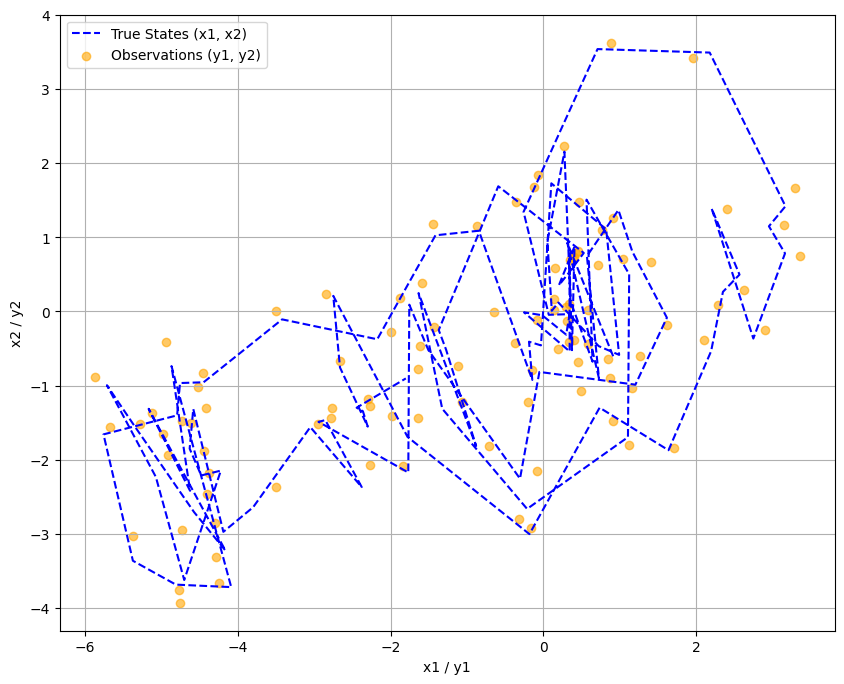

In [23]:
# Plot simulated data on a 2D plot
plt.figure(figsize=(10, 8))

# Plot hidden states and observations
plt.plot(x[:, 0], x[:, 1], label="True States (x1, x2)", color="blue", linestyle="--")
plt.scatter(y[:, 0], y[:, 1], label="Observations (y1, y2)", color="orange", alpha=0.6)

plt.xlabel("x1 / y1")
plt.ylabel("x2 / y2")
plt.legend()
plt.grid()
plt.savefig("report/figs/2d_simulated_data.jpg")
plt.show()

In [64]:
# NBVAL_IGNORE_OUTPUT
# Create an animation of the data
matplotlib.rcParams['animation.embed_limit'] = 2**28

fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(x[:, 0].min() - 1, x[:, 0].max() + 1)
ax.set_ylim(x[:, 1].min() - 1, x[:, 1].max() + 1)
ax.set_title("Animation of Simulated States and Observations")
ax.set_xlabel("x1 / y1")
ax.set_ylabel("x2 / y2")
ax.grid()

true_line, = ax.plot([], [], label="True States (x1, x2)", color="blue", linestyle="--")
obs_scatter = ax.scatter([], [], label="Observations (y1, y2)", color="orange", alpha=0.6)
legend = ax.legend()

def init():
    true_line.set_data([], [])
    obs_scatter.set_offsets(np.empty((0, 2)))
    return true_line, obs_scatter

def update(frame):
    true_line.set_data(x[:frame, 0], x[:frame, 1])
    obs_scatter.set_offsets(y[:frame])
    return true_line, obs_scatter

ani = animation.FuncAnimation(
    fig, update, frames=range(1, T + 1), init_func=init, blit=True, interval=100
)

plt.close()
HTML(ani.to_jshtml())

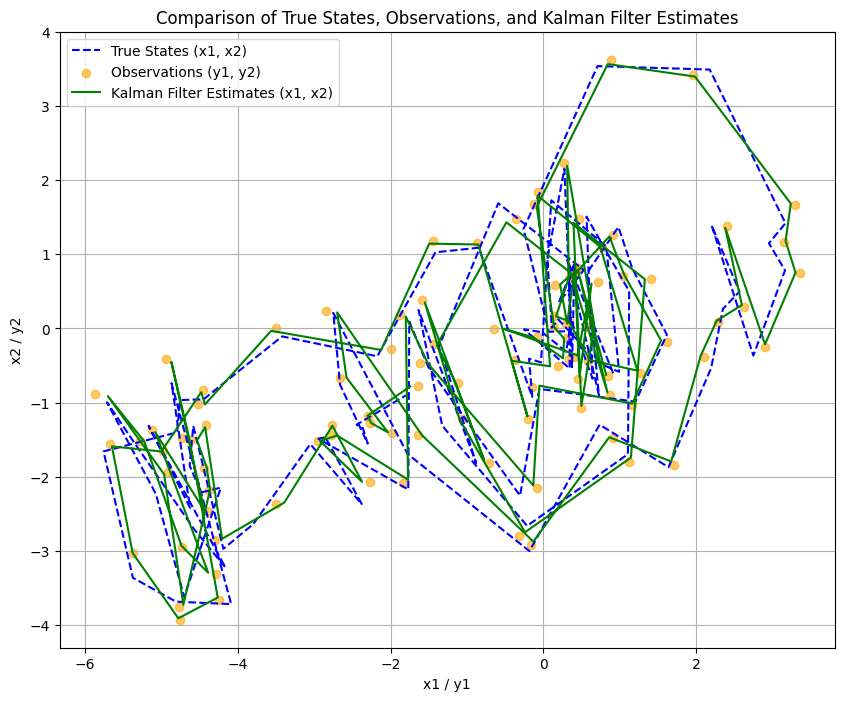

In [25]:
# Apply Kalman filter
mu_filtered, _, log_likelihood_kf = kalman_filter(y, A, Q, C, R, mu_0, Sigma_0)

# Plot the results
plt.figure(figsize=(10, 8))

# True states
plt.plot(x[:, 0], x[:, 1], label="True States (x1, x2)", color="blue", linestyle="--")

# Observations
plt.scatter(y[:, 0], y[:, 1], label="Observations (y1, y2)", color="orange", alpha=0.6)

# Kalman filter estimates
plt.plot(mu_filtered[:, 0], mu_filtered[:, 1], label="Kalman Filter Estimates (x1, x2)", color="green")

# Labels and legend
plt.title("Comparison of True States, Observations, and Kalman Filter Estimates")
plt.xlabel("x1 / y1")
plt.ylabel("x2 / y2")
plt.legend()
plt.grid()
plt.savefig("report/figs/kalman_filter.jpg")
plt.show()

In [66]:
# NBVAL_IGNORE_OUTPUT
# Create an animation of the data and Kalman filter estimates
matplotlib.rcParams['animation.embed_limit'] = 2**28

fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(x[:, 0].min() - 1, x[:, 0].max() + 1)
ax.set_ylim(x[:, 1].min() - 1, x[:, 1].max() + 1)
ax.set_title("Animation of Simulated States and Observations")
ax.set_xlabel("x1 / y1")
ax.set_ylabel("x2 / y2")
ax.grid()

true_line, = ax.plot([], [], label="True States (x1, x2)", color="blue", linestyle="--")
kalman_line, = ax.plot([], [], label="Kalman Filter Estimates (x1, x2)", color="green")
obs_scatter = ax.scatter([], [], label="Observations (y1, y2)", color="orange", alpha=0.6)
legend = ax.legend()

def init():
    true_line.set_data([], [])
    kalman_line.set_data([], [])
    obs_scatter.set_offsets(np.empty((0, 2)))
    return true_line, obs_scatter

def update(frame):
    true_line.set_data(x[:frame, 0], x[:frame, 1])
    kalman_line.set_data(mu_filtered[:frame, 0], mu_filtered[:frame, 1])
    obs_scatter.set_offsets(y[:frame])
    return true_line, obs_scatter

ani = animation.FuncAnimation(
    fig, update, frames=range(1, T + 1), init_func=init, blit=True, interval=100
)
plt.close()
HTML(ani.to_jshtml())

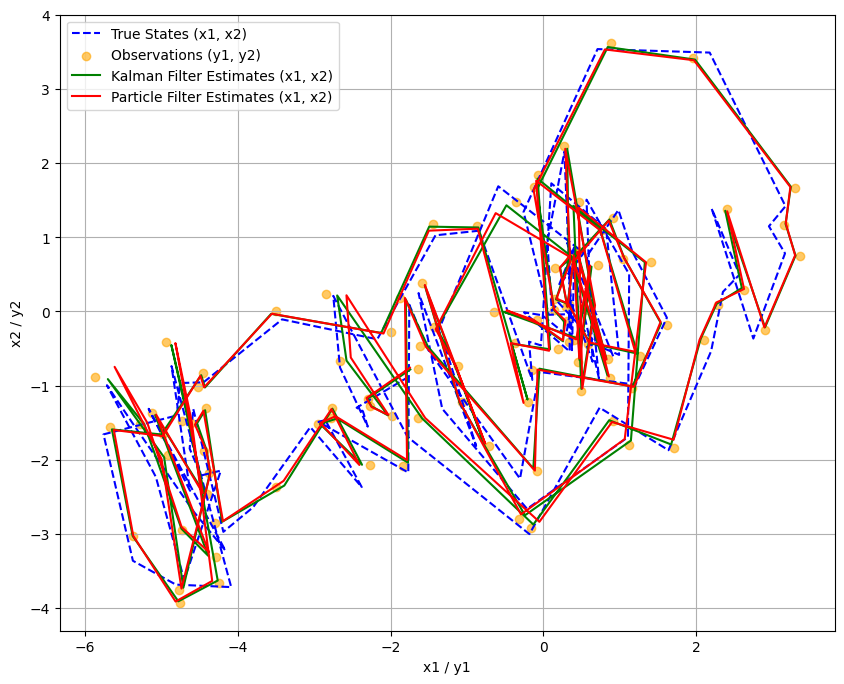

In [26]:
filtered_means, log_likelihood_pf = particle_filter(y, A, Q, C, R, mu_0, Sigma_0, 1000)

# Plot the results
plt.figure(figsize=(10, 8))

# True states
plt.plot(x[:, 0], x[:, 1], label="True States (x1, x2)", color="blue", linestyle="--")

# Observations
plt.scatter(y[:, 0], y[:, 1], label="Observations (y1, y2)", color="orange", alpha=0.6)

# Kalman filter estimates
plt.plot(mu_filtered[:, 0], mu_filtered[:, 1], label="Kalman Filter Estimates (x1, x2)", color="green")

# Particle filter estimates
plt.plot(filtered_means[:, 0], filtered_means[:, 1], label="Particle Filter Estimates (x1, x2)", color="red")

# Labels and legend
plt.xlabel("x1 / y1")
plt.ylabel("x2 / y2")
plt.legend()
plt.grid()
plt.savefig("report/figs/particle_filter.jpg")
plt.show()

In [68]:
# NBVAL_IGNORE_OUTPUT
# Create an animation of the data and particle filter estimates
matplotlib.rcParams['animation.embed_limit'] = 2**28

fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(x[:, 0].min() - 1, x[:, 0].max() + 1)
ax.set_ylim(x[:, 1].min() - 1, x[:, 1].max() + 1)
ax.set_title("Animation of Simulated States and Observations")
ax.set_xlabel("x1 / y1")
ax.set_ylabel("x2 / y2")
ax.grid()

true_line, = ax.plot([], [], label="True States (x1, x2)", color="blue", linestyle="--")
particle_line, = ax.plot([], [], label="Particle Filter Estimates (x1, x2)", color="red")
obs_scatter = ax.scatter([], [], label="Observations (y1, y2)", color="orange", alpha=0.6)
legend = ax.legend()

def init():
    true_line.set_data([], [])
    particle_line.set_data([], [])
    obs_scatter.set_offsets(np.empty((0, 2)))
    return true_line, obs_scatter

def update(frame):
    true_line.set_data(x[:frame, 0], x[:frame, 1])
    particle_line.set_data(filtered_means[:frame, 0], filtered_means[:frame, 1])
    obs_scatter.set_offsets(y[:frame])
    return true_line, obs_scatter

ani = animation.FuncAnimation(
    fig, update, frames=range(1, T + 1), init_func=init, blit=True, interval=100
)
plt.close()
HTML(ani.to_jshtml())

In [27]:
print(f"particle_filter log likelihood: {log_likelihood_pf}, kalman filter likelihood: {log_likelihood_kf}")

particle_filter log likelihood: -209.51638372922218, kalman filter likelihood: -205.54593045947044


In [38]:
particle_settings = [(2**i, 100) for i in range(5, 13)]
log_likelihoods_pf_particles = {}

for num_particles, num_runs in particle_settings:
    print(f"Running particle filter with {num_particles} particles for {num_runs} runs")
    log_likelihoods_pf_particles[(num_particles, num_runs)] = particle_filter_runs(y, A, Q, C, R, mu_0, Sigma_0, num_particles, num_runs)
box_plot_particles(log_likelihoods_pf_particles, figname="particles")

Running particle filter with 32 particles for 100 runs
Running particle filter with 64 particles for 100 runs
Running particle filter with 128 particles for 100 runs
Running particle filter with 256 particles for 100 runs
Running particle filter with 512 particles for 100 runs
Running particle filter with 1024 particles for 100 runs
Running particle filter with 2048 particles for 100 runs
Running particle filter with 4096 particles for 100 runs


Running particle filter with 100 particles for 32 runs
Running particle filter with 100 particles for 64 runs
Running particle filter with 100 particles for 128 runs
Running particle filter with 100 particles for 256 runs
Running particle filter with 100 particles for 512 runs
Running particle filter with 100 particles for 1024 runs
Running particle filter with 100 particles for 2048 runs
Running particle filter with 100 particles for 4096 runs


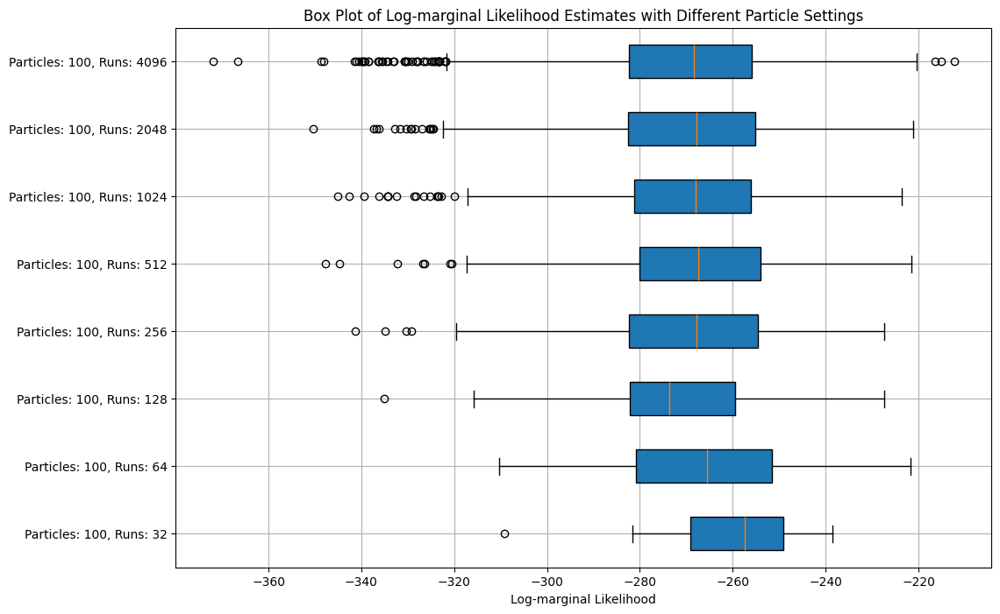

In [41]:
particle_settings = [(100, 2**i) for i in range(5, 13)]
log_likelihoods_pf_runs = {}

for num_particles, num_runs in particle_settings:
    print(f"Running particle filter with {num_particles} particles for {num_runs} runs")
    log_likelihoods_pf_runs[(num_particles, num_runs)] = particle_filter_runs(y, A, Q, C, R, mu_0, Sigma_0, num_particles, num_runs)
box_plot_particles(log_likelihoods_pf_runs, figname="runs")

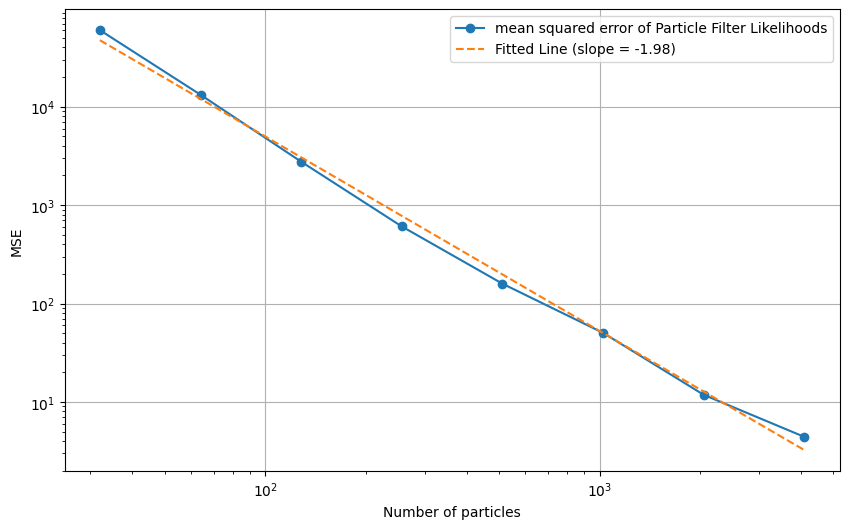

Convergence rate (slope of the line): -1.98


In [44]:
plot_particle_loglog(log_likelihoods_pf_particles, log_likelihood_kf, figname="particles")

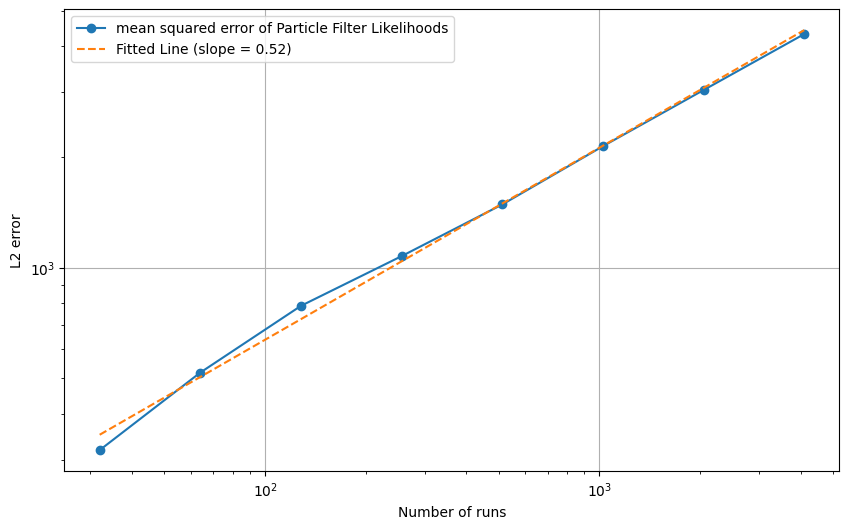

Convergence rate (slope of the line): 0.52


In [45]:
plot_particle_loglog(log_likelihoods_pf_runs, log_likelihood_kf, particles=False, mse=False, figname="runs")

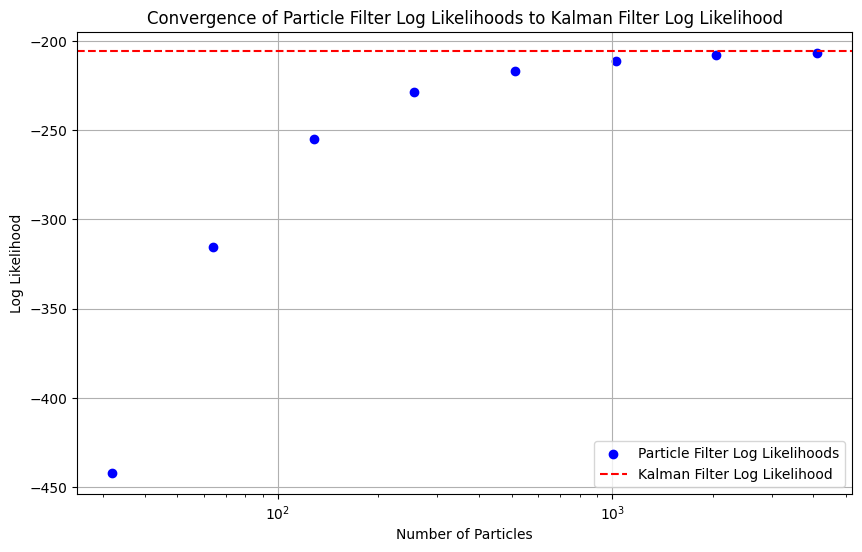

In [48]:
plot_particle_convergence(log_likelihoods_pf_particles, log_likelihood_kf, figname="particles")